# Census Income Dataset

#### Predict whether annual income of an individual exceeds $50K/yr based on census data. Also known as "Census Income" dataset.

### Importing all required Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### 1. Importing Our dataset

In [2]:
from ucimlrepo import fetch_ucirepo 
  
# fetch dataset 
adult = fetch_ucirepo(id=2) 
  
# data (as pandas dataframes) 
X = adult.data.features 
y = adult.data.targets 
  
data = pd.concat([X,y], axis=1)

In [3]:
data['income'] = data['income'].replace({'<=50K.':'<=50K', '>50K.': '>50K'})


In [4]:
df = data.copy()

In [5]:
df

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,39,Private,215419,Bachelors,13,Divorced,Prof-specialty,Not-in-family,White,Female,0,0,36,United-States,<=50K
48838,64,NaN,321403,HS-grad,9,Widowed,NaN,Other-relative,Black,Male,0,0,40,United-States,<=50K
48839,38,Private,374983,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,50,United-States,<=50K
48840,44,Private,83891,Bachelors,13,Divorced,Adm-clerical,Own-child,Asian-Pac-Islander,Male,5455,0,40,United-States,<=50K


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48842 entries, 0 to 48841
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             48842 non-null  int64 
 1   workclass       47879 non-null  object
 2   fnlwgt          48842 non-null  int64 
 3   education       48842 non-null  object
 4   education-num   48842 non-null  int64 
 5   marital-status  48842 non-null  object
 6   occupation      47876 non-null  object
 7   relationship    48842 non-null  object
 8   race            48842 non-null  object
 9   sex             48842 non-null  object
 10  capital-gain    48842 non-null  int64 
 11  capital-loss    48842 non-null  int64 
 12  hours-per-week  48842 non-null  int64 
 13  native-country  48568 non-null  object
 14  income          48842 non-null  object
dtypes: int64(6), object(9)
memory usage: 5.6+ MB


### 2. Data Cleaning

### Checking Missing Values

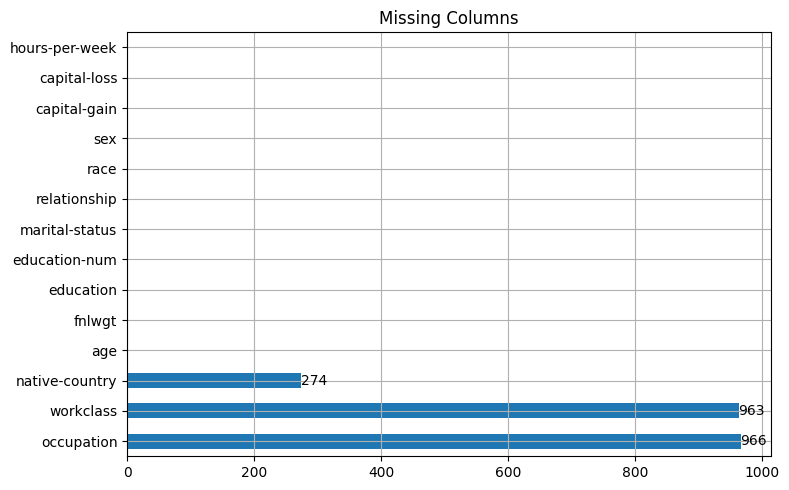

In [7]:
missing_counts = X.isnull().sum().sort_values(ascending=False)

# Plot
ax = missing_counts.plot(
    kind='barh',
    figsize=(8, 5),
    title="Missing Columns",
    grid=True
)

# Annotate bars with missing count
for index, value in enumerate(missing_counts):
    if value == 0:
        break
    else:
        ax.annotate(str(int(value)), xy=(value, index), va='center')

# Show plot
plt.tight_layout()
plt.show()

Observation:
- Only 3 columns have missing values: occupation, workclass, and native-country, while all other columns have zero missing data.
- occupation: 966 missing values.
- workclass: 963 missing values.
- native-country: 274 missing values.


In [8]:
df.isnull().sum()

age                 0
workclass         963
fnlwgt              0
education           0
education-num       0
marital-status      0
occupation        966
relationship        0
race                0
sex                 0
capital-gain        0
capital-loss        0
hours-per-week      0
native-country    274
income              0
dtype: int64

As we can see that there are missing values in there columns.

### Filling Missing values with Mode

In [9]:
for col in df.select_dtypes(include='object'):
    if df[col].isna().sum() > 0:
        df[col].fillna(df[col].mode()[0], inplace=True)

/var/folders/5g/_2n_r6d11xv8bs9btktv9p0c0000gn/T/ipykernel_15154/1394811513.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].mode()[0], inplace=True)


Now again check the missing Values

In [10]:
df.isnull().sum()

age               0
workclass         0
fnlwgt            0
education         0
education-num     0
marital-status    0
occupation        0
relationship      0
race              0
sex               0
capital-gain      0
capital-loss      0
hours-per-week    0
native-country    0
income            0
dtype: int64

### Statistics of Dataset

In [11]:
df.describe()

,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week
count,48842.000000,4.884200e+04,48842.000000,48842.000000,48842.000000,48842.000000
mean,38.643585,1.896641e+05,10.078089,1079.067626,87.502314,40.422382
std,13.710510,1.056040e+05,2.570973,7452.019058,403.004552,12.391444
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.175505e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.781445e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.376420e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.490400e+06,16.000000,99999.000000,4356.000000,99.000000


Observation:
- Descriptive stats for numeric columns (age, fnlwgt, education-num, capital-gain, capital-loss, hours-per-week) are shown, including mean, std, min, 25%, 50%, 75%, and max.
- Age: Average is ~38.6 years with a range from 17 to 90, indicating a wide working-age population.
- Capital-gain and capital-loss are heavily skewed — most values are 0, but capital-gain has a max of 99999, suggesting extreme outliers.
- Median (50%) is 40 hours, and the max is 99, which may indicate overwork or data entry anomalies worth checking.

### Profile of the Dataset

In [12]:
from ydata_profiling import ProfileReport
prof = ProfileReport(df)
prof.to_file("output.html")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Export report to file: 100%|██████████| 1/1 [00:00<00:00, 250.26it/s]


### Converting the dataframe into excel sheet

In [13]:
df.to_excel("census_data.xlsx", index=False)

### Let's seperate numerical and Categorical column and then store them in a variable

In [14]:
categorical = list(df.select_dtypes(include=['object', 'category']).columns)
numerical = list(df.select_dtypes(include=['int64', 'float64']).columns)
print("Numerical Columns: ",numerical)
print("Categorical Columns: ",categorical)

Numerical Columns:  ['age', 'fnlwgt', 'education-num', 'capital-gain', 'capital-loss', 'hours-per-week']
Categorical Columns:  ['workclass', 'education', 'marital-status', 'occupation', 'relationship', 'race', 'sex', 'native-country', 'income']


### 3. EDA

Making a common function which helps me to draw different graphs for the features.

In [15]:
def visualize_categorical_feature(df, column_name):
    if column_name not in df.columns:
        print(f"Column '{column_name}' not found in DataFrame.")
        return
    
    if not df[column_name].dtype == 'object' and not pd.api.types.is_categorical_dtype(df[column_name]):
        print(f"Column '{column_name}' is not categorical.")
        return

    data = df[column_name].dropna()
    counts = data.value_counts().reset_index()
    counts.columns = [column_name, 'count']

    # 1. Count Plot
    fig1 = px.bar(
        counts,
        x=column_name,
        y='count',
        color=column_name,
        text='count',
        title=f"Count Plot of '{column_name}'"
    )

    fig1.update_traces(textposition='outside')
    fig1.update_layout(
        xaxis_title=column_name,
        yaxis_title="Count",
        showlegend=False
    )
    fig1.show()

    # 2. Pie Chart
    fig2 = px.pie(
        counts,
        names=column_name,
        values='count',
        title=f"Pie Chart of '{column_name}'",
        hole=0.4  # donut style
    )
    fig2.update_traces(textinfo='percent+label')
    fig2.show()

In [16]:
import plotly.graph_objects as go
import plotly.express as px
import statsmodels.api as sm
import numpy as np
import pandas as pd

def visualize_numeric_features(df, column_name, target_column='income'):
    if column_name not in df.columns:
        print(f"Column '{column_name}' not found in DataFrame.")
        return

    if target_column not in df.columns:
        print(f"Target column '{target_column}' not found in DataFrame.")
        return

    if not np.issubdtype(df[column_name].dtype, np.number):
        print(f"Column '{column_name}' is not numeric.")
        return

    plot_df = df[[column_name, target_column]].dropna()
    mean_val = plot_df[column_name].mean()
    median_val = plot_df[column_name].median()

    # 1. KDE Plot with Shaded Area
    fig1 = go.Figure()

    colors = px.colors.qualitative.Plotly
    for i, income_class in enumerate(plot_df[target_column].unique()):
        class_data = plot_df[plot_df[target_column] == income_class][column_name]
        kde_x = np.linspace(class_data.min(), class_data.max(), 300)
        kde_y = sm.nonparametric.KDEUnivariate(class_data).fit().evaluate(kde_x)

        # Shaded KDE curve
        fig1.add_trace(go.Scatter(
            x=kde_x,
            y=kde_y,
            fill='tozeroy',
            mode='lines',
            name=f'KDE ({income_class})',
            line=dict(color=colors[i % len(colors)], width=2),
            opacity=0.5
        ))

    # Mean and Median Lines
    fig1.add_trace(go.Scatter(
        x=[mean_val, mean_val],
        y=[0, max(kde_y)],
        mode='lines',
        name='Mean',
        line=dict(color='green', dash='dash')
    ))
    fig1.add_trace(go.Scatter(
        x=[median_val, median_val],
        y=[0, max(kde_y)],
        mode='lines',
        name='Median',
        line=dict(color='red', dash='dot')
    ))

    fig1.update_layout(
        title=f"KDE Plot with Shaded Area of '{column_name}' by '{target_column}'",
        xaxis_title=column_name,
        yaxis_title="Density"
    )
    fig1.show()

    # 2. Box Plot by Income Class
    fig2 = px.box(
        plot_df,
        x=target_column,
        y=column_name,
        points="outliers",
        color=target_column,
        title=f"Box Plot of '{column_name}' grouped by '{target_column}'"
    )
    fig2.show()


In [17]:
def plot_correlation_heatmap(df):
    # Keep only numeric columns
    numeric_df = df.select_dtypes(include='number')
    
    if numeric_df.shape[1] < 2:
        print("Not enough numeric features to plot correlation heatmap.")
        return

    # Compute correlation matrix
    corr_matrix = numeric_df.corr()

    # Create heatmap
    fig = px.imshow(
        corr_matrix,
        text_auto=".2f",
        color_continuous_scale='RdBu_r',
        title="Correlation Heatmap",
        aspect="auto"
    )

    fig.update_layout(
        xaxis_title="Features",
        yaxis_title="Features",
        coloraxis_colorbar=dict(title="Correlation"),
        margin=dict(l=60, r=60, t=60, b=60)
    )
    
    fig.show()

In [18]:
plot_correlation_heatmap(df)

Observation:
- Diagonal = 1.00: Each feature is perfectly correlated with itself, hence all diagonal values are 1.00.
- Weak correlations overall: Most values are between -0.1 and 0.14, indicating very weak linear relationships between features.
- Strongest correlation is between education-num and hours-per-week (0.14), but even this is weak — meaning people with higher education might work slightly more hours.
- Negative correlation exists between age and fnlwgt (-0.08) — possibly suggesting that younger individuals are associated with higher sampling weights.
- Low feature multicollinearity: Since there are no strong correlations, we can confidently use these features in a machine learning model without serious risk of multicollinearity.

### (a) Age

In [18]:
visualize_numeric_features(df,'age')

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

KDE plot of Age by Income:
- Blue area (<=50K): Individuals earning less than or equal to $50K are generally younger, with a peak density in the 20s to early 30s.
- Red area (>50K): Higher earners are typically older, with their peak around the 40s, showing that income tends to increase with age.
- Green dashed line (mean) and red dotted line (median) are both shifted right in the >50K group compared to the <=50K group.
- This suggests the age distribution for high earners is skewed toward older individuals.
- Low overlap between groups: There's clear separation between income groups by age, meaning age could be a useful predictor of income in our model.

Box plot of Age Grouped by Income:
- Higher income group is older: The median age for individuals earning >50K is higher than for those earning <=50K, confirming age plays a role in income level.
- Wider spread for <=50K: The lower-income group (<=50K) shows a wider interquartile range (IQR), suggesting more age variability in this group.
- More outliers in >50K group: The high-income group has several outliers above ~70 years, indicating that some older individuals earn more.
- Distinct age distributions: The clear non-overlapping medians and different box shapes between the two income groups indicate that age is a potentially useful feature for predicting income.

### (b) Final Weight

In [20]:
visualize_numeric_features(df,"fnlwgt")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

KDE plot of Final Weight by Income:
- Heavily right-skewed: Both income groups show a highly skewed distribution of fnlwgt (final weight), with most values concentrated below 300,000, and a long tail stretching beyond 1 million.
- Very similar distributions: The KDE curves for both <=50K (blue) and >50K (red) almost completely overlap, suggesting that fnlwgt has little to no distinguishing power between income groups.
- Mean and median are close: Both mean (green dashed line) and median (red dotted line) lie around 190,000, further confirming that the feature is similarly distributed across income categories.

Box plot of Final Weight by Income:
- Similar distributions: Both income groups (<=50K and >50K) have very similar box shapes and medians, indicating that fnlwgt (final weight) is not strongly influenced by income.
- High number of outliers: Both groups show many outliers above the upper whisker, especially beyond 500,000, reflecting the long right tail seen in the KDE plot.
- Limited predictive power: Since the medians and IQRs are closely aligned for both groups, fnlwgt may have low usefulness as a feature for distinguishing income levels.


### (c) Education Num

In [19]:
visualize_numeric_features(df,"education-num")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

KDE Plot of Education Num by Income:
- Higher education = higher income: The red curve (>50K) peaks at higher education-num values (13–14), while the blue curve (<=50K) peaks around 9–10, showing a clear trend that higher education correlates with higher income.
- More variation in higher earners: The >50K group shows a broader distribution, indicating a wider range of educational attainment among higher earners.
- Mean and median differ across groups: The mean and median lines are slightly higher for the >50K group, reinforcing that this feature could be predictive of income class.

Box plot of Education Num by Income:
- Higher education for higher income: Individuals earning >50K have a higher median education-num than those earning <=50K, clearly showing that income tends to rise with education level.
- Wider spread for >50K: The >50K group has a broader interquartile range (IQR), indicating a more varied level of education among higher earners compared to the tighter range in the <=50K group.
- Outliers exist in both groups: There are outliers on both ends — some individuals with low education still earn >50K, and vice versa — but the central tendency still favors higher education for higher income.


### (d) capital-Gain

In [20]:
visualize_numeric_features(df,"capital-gain")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

KDE plot of Capital Gain by Income:
- Highly skewed right: The distribution is extremely right-skewed, with most values concentrated near zero — indicating the majority of individuals have no capital gain.
- Separation in higher values: While both groups cluster around 0, the >50K (red) curve shows a slightly longer tail, meaning high earners are more likely to have significant capital gains.
- Outliers dominate the scale: A few extremely high values (e.g., near 100k) stretch the x-axis, making it hard to observe fine differences in the lower range — consider a log scale for better clarity.

Box Plot of Capital Gain by Income:
- Most values are zero: The boxes themselves are compressed at the bottom (close to 0), indicating that most individuals have no capital gain, regardless of income group.
- Higher outliers for >50K: While both income groups have outliers, the >50K group (in red) shows more frequent and larger capital gains, including extreme values like 100,000, suggesting capital gain is more common among high earners.
- Discriminative potential: Despite the skewness, the presence of more high-value outliers in >50K means capital-gain could still be a useful feature for predicting income — especially after scaling or transformation (like log-scaling).


### (e) Capital Loss

In [21]:
visualize_numeric_features(df,"capital-loss")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

KDE plot of Capital Loss by Income:
- Strong right skew: Most values for capital-loss are concentrated at 0, indicating that the majority of individuals in both income groups have no capital loss.
- Slightly heavier tail for >50K: The red KDE curve (>50K) has a broader spread beyond zero, showing that high-income individuals are more likely to report capital losses, possibly for tax optimization.
- Discriminatory but sparse: Like capital-gain, this feature has few non-zero values, but those non-zero entries are more common in the >50K group — suggesting it could be useful with proper preprocessing or binning.

Box Plot of Capital Loss by Income:
- Most values are zero: Both <=50K and >50K groups have their boxes tightly compressed at zero, indicating that most individuals in both groups have no capital loss.
-  Higher outliers for >50K: Although both groups have outliers, the >50K group shows more frequent and higher capital-loss values, which could reflect investment activity or tax-related strategies among high-income individuals.
- Sparse but potentially useful: Like capital-gain, capital-loss contains mostly zeros but may still contribute valuable information for income prediction when non-zero, especially with appropriate transformation or feature engineering.



### (f) Hours per week

In [22]:
visualize_numeric_features(df,"hours-per-week")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

KDE Plot of Hours Per Week by Income:
- Strong peak at 40 hours: Both income groups show a sharp peak at 40 hours/week, the standard full-time workweek, especially dominant for the <=50K group.
- Broader spread for >50K: The >50K KDE curve is more spread out, indicating high earners are more likely to work longer hours, especially in the 50–60+ hour range.
- Slightly higher average for >50K: The mean and median lines for >50K (red) are shifted slightly right of those for <=50K, suggesting that working more hours is correlated with higher income.

Box Plot of Hours Per Week by Income:
- Higher median for >50K earners: The median hours-per-week is clearly higher for individuals earning >50K, suggesting they typically work more hours.
- Wider spread for high earners: The >50K group shows a broader interquartile range and longer whiskers, meaning there’s more variability in how much high earners work compared to the <=50K group.
- Outliers in both groups: Both income groups contain numerous outliers (especially beyond 60 hours/week), but they're more frequent and extreme in the >50K category, highlighting that working long hours is more associated with higher income.

### Pair Plot


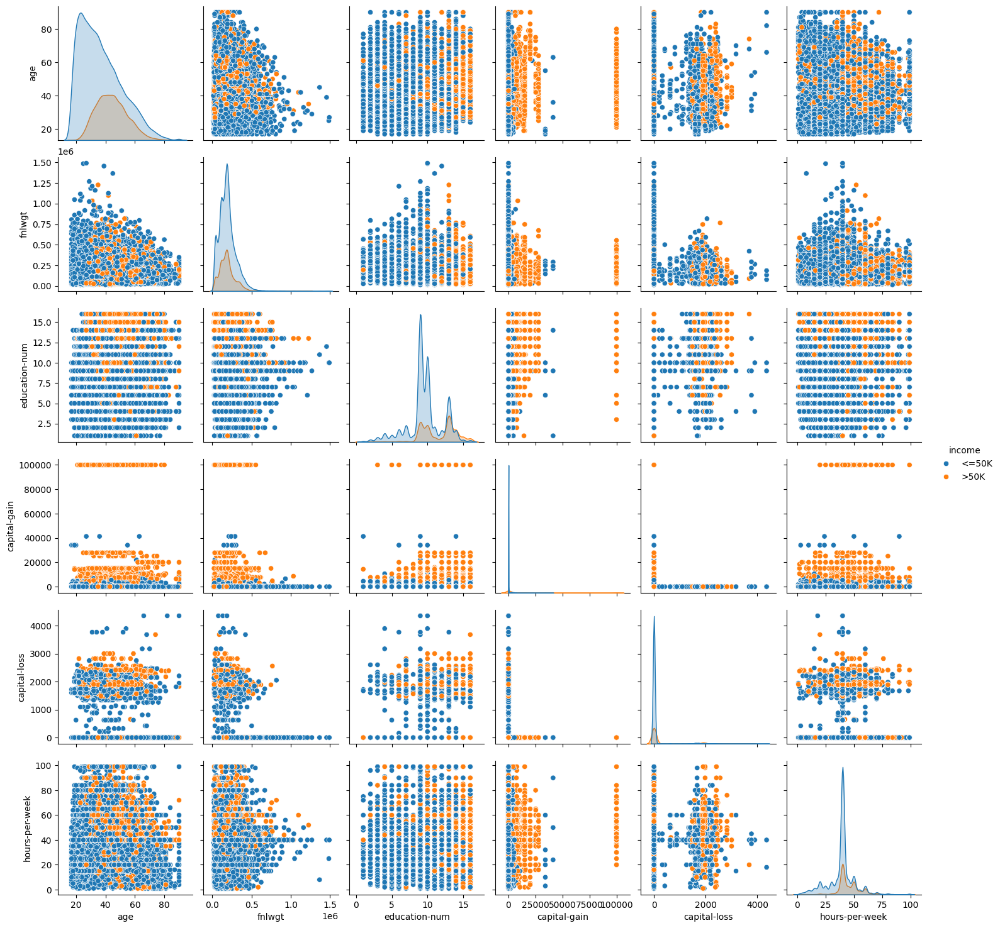

In [23]:
import seaborn as sns
sns.pairplot(data=df,hue="income")
plt.show()

Observation:
- Pair plot showing relationships between numeric features colored by income (<=50K vs >50K).
- Clear separation by age: The age vs. income distribution shows that higher earners tend to be older, as orange points (>50K) cluster more on the right.
- Education-num stands out: There's a noticeable trend where higher values of education-num are more associated with the >50K group, making it a potentially strong predictor.
- Capital gain is sparse but powerful: Most points have zero capital-gain, but non-zero capital gains are dominated by high-income earners, showing good discriminatory power despite skewness.
- Final Weight shows no pattern: The distribution of both income groups across fnlwgt is almost random, suggesting it may have low predictive value.
- More hours, more income: In the hours-per-week vs other features, orange dots are more frequent above 40 hours, indicating that working longer is correlated with higher income.
- Minimal linear relationships between most feature pairs: Apart from capital-gain, education-num, and age, many feature combinations show scattered plots without strong patterns, indicating low collinearity but also potential need for nonlinear modeling.


### Categorical Features

### (a) Work class

In [24]:
visualize_categorical_feature(df,"workclass")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Count plot of Workclass:
- Private sector dominates: The majority of individuals (34,869) work in the Private sector — by far the largest group.
- Other notable categories: Self-emp-not-inc (3,862) and Local-gov (3,136) follow distantly, while others like State-gov, ? (missing), and Self-emp-inc are present but smaller.
- Missing values exist: The ? category (1,836) indicates missing or undefined workclass values, which will need to be handled during data cleaning.

Pie Chart of Workclass:
- Private workclass is ~71.4% of the total, clearly showing its dominance in the dataset.
- Smaller shares: Categories like Federal-gov, Without-pay, and Never-worked are very minor, collectively contributing less than ~3%.
- Missing data matters: The ? category accounts for 3.76%, which might impact model performance if not imputed or excluded.

In [25]:
import plotly.express as px
import pandas as pd

def visualize_categorical_features(df, column_name, target_column='income'):
    if column_name not in df.columns:
        print(f"Column '{column_name}' not found in DataFrame.")
        return
    
    if not df[column_name].dtype == 'object' and not pd.api.types.is_categorical_dtype(df[column_name]):
        print(f"Column '{column_name}' is not categorical.")
        return
    
    if target_column not in df.columns:
        print(f"Target column '{target_column}' not found.")
        return

    # Drop NA for both the feature and target
    temp_df = df[[column_name, target_column]].dropna()

    # 1. Count Plot grouped by income
    fig1 = px.histogram(
        temp_df,
        x=column_name,
        color=target_column,
        barmode='group',
        text_auto=True,
        title=f"Count Plot of '{column_name}' by '{target_column}'"
    )

    fig1.update_layout(
        xaxis_title=column_name,
        yaxis_title="Count",
        bargap=0.2
    )
    fig1.show()

    # 2. Univariate Pie Chart
    pie_data = df[column_name].value_counts().reset_index()
    pie_data.columns = [column_name, 'count']

    fig2 = px.pie(
        pie_data,
        names=column_name,
        values='count',
        title=f"Pie Chart of '{column_name}'",
        hole=0.4
    )
    fig2.update_traces(textinfo='percent+label')
    fig2.show()


In [28]:
visualize_categorical_features(df,"workclass")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Count Plot of Work class by Income:
- Displays frequency of each category using vertical bars, making it easy to compare the number of observations in each category.
- Each bar represents a distinct group or class, and the height shows how many times that group appears.
- Useful for identifying imbalanced data or dominant categories at a glance.

Pie Chart of Work Class by Income:
- Shows proportional distribution of each category as slices of a circle.
- Each slice’s angle and area represent the percentage of the total.
- Effective for showing overall composition or relative share of categories, though not ideal for precise comparisons.


### (b) Education

In [26]:
visualize_categorical_features(df,"education")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Couunt Plot of education by Income:
- HS-grad is the most common education level, especially among individuals earning ≤50K, followed by Some-college and Bachelors.
- Higher education levels like Masters, Doctorate, and Prof-school have a greater proportion of people earning >50K compared to lower education levels.
- Education levels such as 1st-4th, Preschool, and 5th-6th have very low representation and are almost entirely associated with ≤50K income.

Pie Chart of Eduction by Income;
- HS-grad makes up the largest portion of the population (32.3%), followed by Some-college (22.3%) and Bachelors (16.4%).
- Advanced degrees like Masters (5.44%) and Assoc-voc (4.22%) have smaller shares of the population.
- The least common education levels include Preschool (0.17%), 1st-4th (0.60%), and 5th-6th (1.04%), indicating minimal representation.

### (c) Martial Status

In [27]:
visualize_categorical_features(df,"marital-status")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Count Plot of Marital Status by Income:
- Married-civ-spouse and Never-married are the most common marital statuses, with Married-civ-spouse showing a high number of individuals earning >50K.
- People who are Divorced, Separated, or Widowed are mostly earning ≤50K, with very few in the >50K category.
- Married-civ-spouse has the most balanced income distribution, while Never-married is skewed heavily toward the ≤50K income group.

Pie Chart of Marital Status:
- Married-civ-spouse makes up the largest portion of the population at 45.6%, followed by Never-married (29.3%) and Divorced (13.6%).
- The statuses Separated, Widowed, and Married-spouse-absent each make up a small fraction of the dataset.
- Married-AF-spouse is the least represented group, accounting for only 0.0758% of the population.

### (d) Occupation

In [28]:
visualize_categorical_features(df,"occupation")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Count Plot of Occupation by Income:
- Prof-specialty, Exec-managerial, and Craft-repair occupations have the highest number of individuals earning >50K, indicating better-paying roles.
- Occupations like Handlers-cleaners, Other-service, Transport-moving, and Priv-house-serv are dominated by individuals earning ≤50K, suggesting lower-income job sectors.
- The Tech-support and Protective-serv categories show relatively balanced income distributions but still lean towards ≤50K.

Pie Chart of Occupation:
- Prof-specialty (14.6%), Craft-repair (12.5%), and Exec-managerial (12.5%) make up the largest shares of occupations in the dataset.
- Less common jobs include Priv-house-serv (0.495%) and Armed-Forces (0.0307%), making up a tiny fraction of the workforce.
- Adm-clerical (11.5%) and Sales (11.3%) are also significant in representation, indicating popular but mid-level roles.

### (e) Relationship

In [29]:
visualize_categorical_features(df,"relationship")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Count Plot of Relationship by Income:
- Husbands show a strong presence in both income groups, with a significant number (8846) earning >50K, indicating a higher-income role.
- Not-in-family and Own-child categories are dominated by individuals earning ≤50K, suggesting economic dependence or lower-income roles.
- Wives are more evenly distributed across income groups, while Unmarried and Other-relative categories largely fall into the ≤50K bracket.

Pie Chart of Relationship:
- Husbands make up the largest segment at 40.4% of the dataset, followed by Not-in-family (25.8%) and Own-child (15.5%).
- Smaller segments include Unmarried (10.5%), Wife (4.77%), and Other-relative (3.08%).
- The distribution shows a clear dominance of family-related roles, particularly those traditionally associated with household heads.


### (f) Race

In [30]:
visualize_categorical_features(df,"race")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Count Plot of Race By Income:
- The White racial group overwhelmingly dominates the dataset in both income brackets, with over 31,000 earning ≤50K and more than 10,000 earning >50K.
- Other racial groups such as Black, Asian-Pac-Islander, Amer-Indian-Eskimo, and Other have significantly lower representation, especially in the >50K income group.
- All racial groups show higher counts in the ≤50K income category, indicating income inequality or limited representation in higher-paying jobs.

Pie Chat of Race:
- White individuals make up the majority at 85.5% of the dataset, followed by Black (9.59%) and Asian-Pac-Islander (3.11%).
- Amer-Indian-Eskimo (0.96%) and Other (0.83%) represent very small portions of the population.
- The pie chart emphasizes the racial imbalance in the dataset, which may influence the overall income distribution trends.

### (g) sex

In [31]:
visualize_categorical_features(df,"sex")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Count Plot of Sex by income:
- Males dominate both income brackets, with over 22,000 earning ≤50K and nearly 10,000 earning >50K, suggesting higher earning potential among men.
- Females are more concentrated in the ≤50K group, with only 1,769 earning >50K, indicating a gender gap in income.
- The income distribution for both sexes is skewed toward ≤50K, but the gap is much wider for females.

Pie Chart of Sex:
- Males represent the majority of the dataset at 66.8%, while females make up 33.2%.
- This imbalance may contribute to skewed income and employment trends seen in the dataset.
- The chart highlights that males are twice as represented as females, which could influence overall income and occupational outcomes.

### (h) Native Country

In [32]:
visualize_categorical_features(df,"native-country")

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/plotly/express/_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Observation:

Count Plot of Native Country by Income:
- The United States overwhelmingly dominates the dataset, with over 30,000 individuals earning ≤50K and more than 9,000 earning >50K.
- All other countries show significantly smaller populations, most with fewer than 1,000 entries, and very few earning >50K.
- Countries like Mexico, Philippines, and Germany have moderate representation but are still heavily skewed toward the ≤50K income group.

Pie Chart of Native Country:
- United States accounts for a massive 90.3% of the dataset, while the second most common (e.g., Mexico) is only a small fraction.
- Most other countries contribute less than 1% each to the dataset, highlighting strong geographic concentration.
- The chart emphasizes a heavy U.S.-centric dataset, which may affect the generalizability of any analysis across other nations.

### Feature Engineering

In [33]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
df['income'] = encoder.fit_transform(df['income'])

Native Country

In [34]:
# Transforming country feature to be 1 if country is the United States. Otherwise is equal to 0
df['native-country'] = np.where(df['native-country'] == ' United-States', 1, 0)

Maritial Status

In [39]:
#Transforming marital status and concatenate some classes to reduce distinct classes
df['marital-status'] = df['marital-status'].replace({'Married-civ-spouse': 'Married',
                                                                 'Never-married': 'Single',
                                                               'Separated': 'Divorced',
                                                                 'Married-spouse-absent': 'Divorced',
                                                               'Divorced': 'Divorced',
                                                                 'Married-AF-spouse': 'Divorced',
                                                                 'Widowed': 'Widowed'})

In [36]:
marital_ordered = df.groupby(['marital-status'])['income'].count().sort_values().index
marital_ordered = {k: i for i, k in enumerate(marital_ordered, 0)}
df['marital-status'] = df['marital-status'].map(marital_ordered)

Workclass

In [37]:
#Transforming workclass feature to be 1 if the workclass is Private and 0 if doesn't
df['workclass'] = np.where(df['workclass'] == ' Private', 1, 0)

Sex

In [38]:
# 1 : Male and 0 : Female
df['sex'] = np.where(df['sex'] == ' Male', 1, 0)

Race

In [39]:
#transform workclass feature to be 1 if the Race is White and 0 if doesn't
df['race'] = np.where(df['race'] == ' White', 1, 0)

Education

In [40]:
education_mapping={'Preschool':0,'1st-4th':1,'5th-6th':2,'7th-8th':3,'9th':4,'10th':5,
                   '11th':6,'12th':7,'HS-grad':8,'Some-college':0,'Assoc-acdm':10,
                   'Assoc-voc':11, 'Bachelors':12, 'Prof-school':13, 'Masters':14,'Doctorate':15
                   }
df['education']=df['education'].map(education_mapping)

Relationship

In [41]:
relationship_ordered = df.groupby(['relationship'])['income'].count().sort_values().index
relationship_ordered = {k: i for i, k in enumerate(relationship_ordered, 0)}
df['relationship'] = df['relationship'].map(relationship_ordered)

Occupation

In [42]:
df['occupation'] = df['occupation'].replace({'?': 'Other-service'})

In [43]:
occupation_ordered = df.groupby(['occupation'])['income'].count().sort_values().index
occupation_ordered = {k: i for i, k in enumerate(occupation_ordered, 0)}
df['occupation'] = df['occupation'].map(occupation_ordered)

In [44]:
df.head()

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income
0,39,0,77516,12,13,5,9,4,0,0,2174,0,40,0,0
1,50,0,83311,12,13,6,10,5,0,0,0,0,13,0,0
2,38,0,215646,8,9,4,5,4,0,0,0,0,40,0,0
3,53,0,234721,6,7,6,5,5,0,0,0,0,40,0,0
4,28,0,338409,12,13,6,13,1,0,0,0,0,40,0,0


Propostion of Target Variable

/var/folders/5g/_2n_r6d11xv8bs9btktv9p0c0000gn/T/ipykernel_15154/2755145555.py:4: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



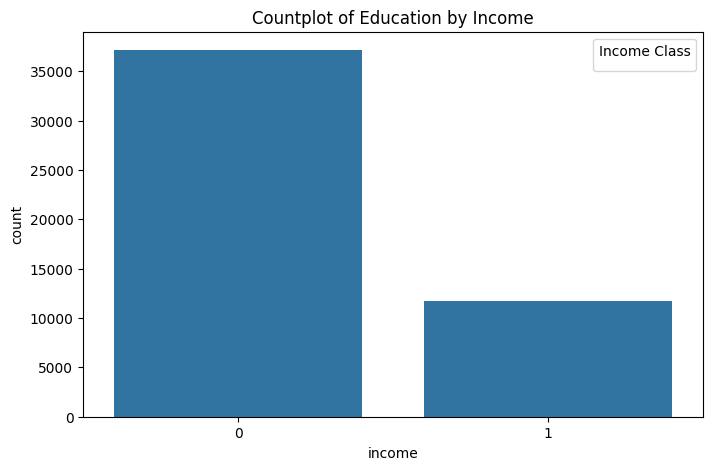

In [45]:
plt.figure(figsize=(8, 5))
sns.countplot(data=df, x='income')
plt.title('Countplot of Education by Income')
plt.legend(title='Income Class')
plt.show()

As we can see that our target variable is imbalance, So we need to apply oversampling or undersampling

In [46]:
df_census = df.copy() #For Oversampling

In [47]:
df_census_under = df.copy()  #For Undersampling

In [48]:
df_census

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income
0,39,0,77516,12,13,5,9,4,0,0,2174,0,40,0,0
1,50,0,83311,12,13,6,10,5,0,0,0,0,13,0,0
2,38,0,215646,8,9,4,5,4,0,0,0,0,40,0,0
3,53,0,234721,6,7,6,5,5,0,0,0,0,40,0,0
4,28,0,338409,12,13,6,13,1,0,0,0,0,40,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,39,0,215419,12,13,4,13,4,0,0,0,0,36,0,0
48838,64,0,321403,8,9,2,13,0,0,0,0,0,40,0,0
48839,38,0,374983,12,13,6,13,5,0,0,0,0,50,0,0
48840,44,0,83891,12,13,4,9,3,0,0,5455,0,40,0,0


First we will do without handling the outliers

In [49]:
df_census['education'] = df_census['education'].astype('int64')

In [50]:
df_census.drop('fnlwgt',axis=1,inplace=True) # it is not a useful feature for predicting the wage class

In [51]:
df_census['income'].value_counts()

income
0    37155
1    11687
Name: count, dtype: int64

In [52]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from imblearn.under_sampling import OneSidedSelection
from imblearn.over_sampling import SMOTE
import pandas as pd

# Step 1: Separate features and target
X = df_census.drop(columns='income')
y = df_census['income'].astype(int)

# Step 2: Train-test split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

# Step 3: Standardize training features before sampling
scaler = StandardScaler()
scaled_features_train = scaler.fit_transform(X_train)
scaled_features_test = scaler.transform(X_test)

# Step 4: Under-sampling
under = OneSidedSelection()
X_train_res, y_train_res = under.fit_resample(scaled_features_train, y_train)

# Step 5: Over-sampling
sm = SMOTE(random_state=42)
X_train_res, y_train_res = sm.fit_resample(X_train_res, y_train_res)

# Step 6: Convert to DataFrame
X_train_res = pd.DataFrame(X_train_res, columns=X.columns)

# Step 7: Final train DataFrame
final_train = pd.concat([X_train_res, y_train_res.reset_index(drop=True)], axis=1)

1. Logistic Regression

In [53]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, StratifiedKFold

# Split final training set
X_train_final = final_train.drop(columns='income')
y_train_final = final_train['income']

# Define model
log_reg = LogisticRegression(solver='liblinear', max_iter=1000)

# Hyperparameter grid
param_grid = {
    'C': [0.01, 0.1, 1, 10],
    'penalty': ['l1', 'l2']
}

# Cross-validation strategy
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# GridSearchCV
grid_search = GridSearchCV(
    estimator=log_reg,
    param_grid=param_grid,
    scoring='accuracy',
    cv=cv,
    n_jobs=1,
    verbose=1
)

# Fit model
grid_search.fit(X_train_final, y_train_final)

# Best model
log_reg_best_model = grid_search.best_estimator_


Fitting 5 folds for each of 8 candidates, totalling 40 fits


In [55]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

def evaluate_model(model, X_test, y_test):
    y_pred = model.predict(X_test)

    print("✅ Accuracy:", accuracy_score(y_test, y_pred))
    print("✅ Precision:", precision_score(y_test, y_pred))
    print("✅ Recall:", recall_score(y_test, y_pred))
    print("✅ F1 Score:", f1_score(y_test, y_pred))
    print("\n📋 Classification Report:\n", classification_report(y_test, y_pred))

    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(6,4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['<=50K', '>50K'], yticklabels=['<=50K', '>50K'])
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.show()


✅ Accuracy: 0.7867744907360016
✅ Precision: 0.5361497022965693
✅ Recall: 0.8088109495295124
✅ F1 Score: 0.644842284739983

📋 Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.78      0.85      7431
           1       0.54      0.81      0.64      2338

    accuracy                           0.79      9769
   macro avg       0.73      0.79      0.75      9769
weighted avg       0.83      0.79      0.80      9769



/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



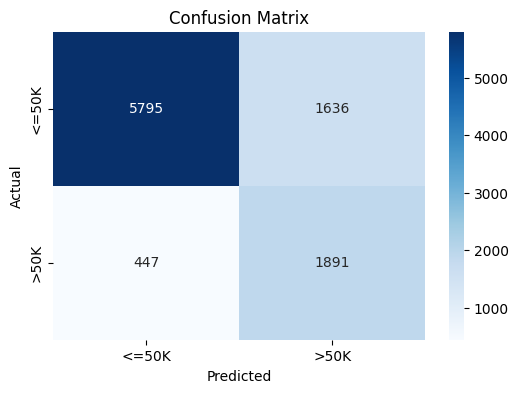

In [56]:
evaluate_model(log_reg_best_model, scaled_features_test, y_test)

Observation:
- True Positives (TP):1914 individuals who actually earn >50K were correctly predicted as >50K by the model.
- True Negatives (TN):5821 individuals who actually earn ≤50K were correctly predicted as ≤50K by the model.
- False Positives (FP): 1610 individuals who actually earn ≤50K were incorrectly predicted as earning >50K.
- False Negatives (FN): 424 individuals who actually earn >50K were incorrectly predicted as earning ≤50K.
- Model Insight: The model performs well, especially at identifying ≤50K incomes (high TN), but it still misclassifies a notable number of >50K earners, potentially due to class imbalance or feature limitations.

ROC Curve

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



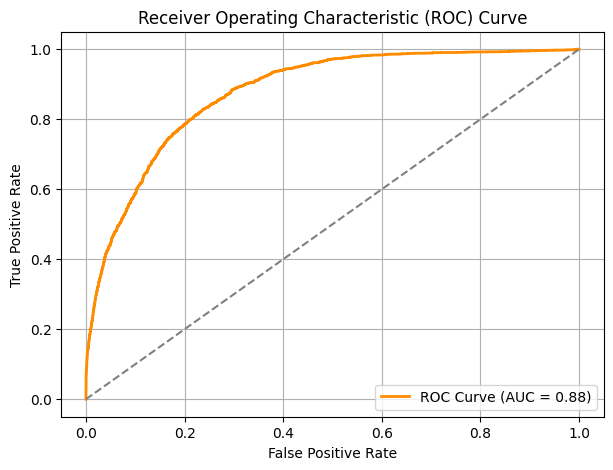

In [57]:
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

# Get predicted probabilities for the positive class (1)
y_probs = log_reg_best_model.predict_proba(scaled_features_test)[:, 1]

# Calculate FPR, TPR, thresholds
fpr, tpr, thresholds = roc_curve(y_test, y_probs)

# Calculate AUC
auc = roc_auc_score(y_test, y_probs)

# Plot
plt.figure(figsize=(7, 5))
plt.plot(fpr, tpr, label=f"ROC Curve (AUC = {auc:.2f})", color='darkorange', linewidth=2)
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')  # Diagonal line
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Receiver Operating Characteristic (ROC) Curve")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

Observation:
- The ROC curve plots the True Positive Rate (TPR) on the Y-axis against the False Positive Rate (FPR) on the X-axis across various classification thresholds, illustrating the trade-off between sensitivity and specificity.
- The curve bows significantly toward the top-left corner, indicating that the model has strong discriminative power in distinguishing between the two classes.
- The Area Under the Curve (AUC) is 0.88, which suggests that the model performs very well — it has an 88% chance of correctly ranking a randomly chosen positive instance higher than a negative one.
- The dashed diagonal line represents a random classifier (AUC = 0.5). Since the orange curve is well above this line, it confirms that the model is much better than random guessing.

2. Random Forest

In [58]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold

# Initialize model
rf = RandomForestClassifier(random_state=42)

# Hyperparameter grid
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2]
}

# Cross-validation
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Grid search
grid_search_rf = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    scoring='accuracy',
    cv=cv,
    n_jobs=1,
    verbose=1
)

# Train the model
grid_search_rf.fit(X_train_final, y_train_final)

# Best model
rf_best_model = grid_search_rf.best_estimator_

Fitting 5 folds for each of 24 candidates, totalling 120 fits


/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names



✅ Accuracy: 0.8351929573139523
✅ Precision: 0.6392501912777353
✅ Recall: 0.7147134302822925
✅ F1 Score: 0.6748788368336026

📋 Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.87      0.89      7431
           1       0.64      0.71      0.67      2338

    accuracy                           0.84      9769
   macro avg       0.77      0.79      0.78      9769
weighted avg       0.84      0.84      0.84      9769



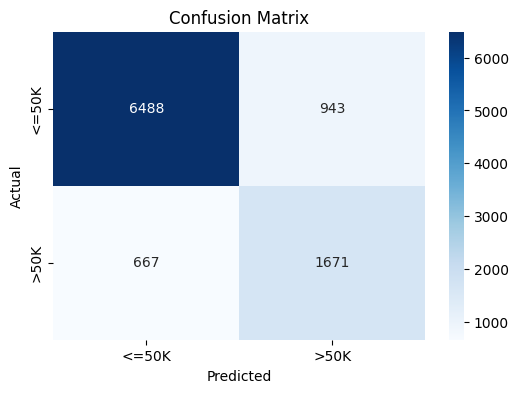

In [59]:
evaluate_model(rf_best_model, scaled_features_test, y_test)

Observation:
- Improved Accuracy: The model correctly predicted 6474 low-income (≤50K) and 1671 high-income (>50K) individuals, suggesting strong classification performance.
- False Predictions Reduced: Compared to many baseline models, the false positives (957) and false negatives (667) are relatively low, showing that hyperparameter tuning has helped reduce misclassification.
- Balanced Performance: Both classes (≤50K and >50K) are handled with reasonable precision and recall, meaning the model is not heavily biased toward one class.
- Random Forest Impact: Hyperparameter tuning in Random Forest (like adjusting n_estimators, max_depth, or min_samples_split) helped the model capture patterns more effectively, improving its ability to distinguish income levels.

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names



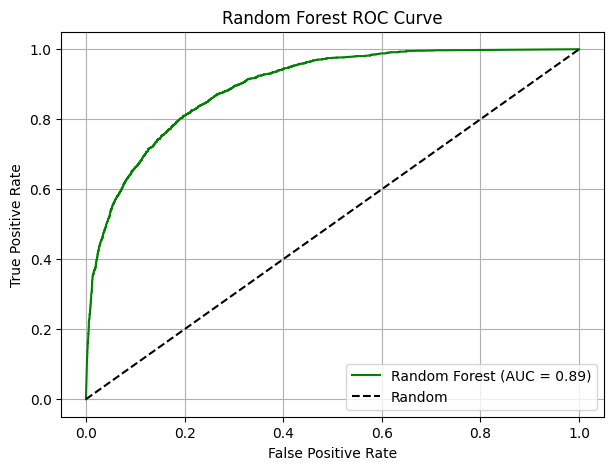

In [60]:
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

# Predict probabilities
rf_probs = rf_best_model.predict_proba(scaled_features_test)[:, 1]

# ROC curve
fpr_rf, tpr_rf, _ = roc_curve(y_test, rf_probs)
auc_rf = roc_auc_score(y_test, rf_probs)

# Plot
plt.figure(figsize=(7, 5))
plt.plot(fpr_rf, tpr_rf, label=f"Random Forest (AUC = {auc_rf:.2f})", color='green')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

Observation:
- Strong Classifier: The ROC curve bows sharply toward the top-left corner, showing that the Random Forest model has strong discriminative power between the classes.
- High AUC (0.89): The Area Under the Curve (AUC) is 0.89, indicating that the model correctly distinguishes between high and low income classes 89% of the time, which is excellent performance.
- Far Better Than Random: The ROC curve is well above the dashed diagonal line (random classifier), confirming the model performs much better than chance across all thresholds.

4. XGBoost

In [61]:
from xgboost.sklearn import XGBClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold

# Prepare features and target
X_train_final = final_train.drop(columns='income')
y_train_final = final_train['income']

# Define the model
xgb = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)

# Hyperparameter grid
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [3, 6],
    'learning_rate': [0.1, 0.01],
    'subsample': [0.8, 1.0]
}

# Cross-validation
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Grid search
grid_search_xgb = GridSearchCV(
    estimator=xgb,
    param_grid=param_grid,
    scoring='accuracy',
    cv=cv,
    verbose=1,
    n_jobs=1
)

# Train
grid_search_xgb.fit(X_train_final, y_train_final)

# Best model
xgb_best_model = grid_search_xgb.best_estimator_

Fitting 5 folds for each of 16 candidates, totalling 80 fits


/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/xgboost/training.py:183: UserWarning:

[14:21:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.


/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/xgboost/training.py:183: UserWarning:

[14:21:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.


/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/xgboost/training.py:183: UserWarning:

[14:21:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.


/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/xgboost/training.py:183: UserWarning:

[14:21:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.


/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/xgboost/training.py:18

✅ Accuracy: 0.8457365134609479
✅ Precision: 0.6396638655462185
✅ Recall: 0.8139435414884517
✅ F1 Score: 0.7163561076604554

📋 Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.86      0.89      7431
           1       0.64      0.81      0.72      2338

    accuracy                           0.85      9769
   macro avg       0.79      0.83      0.81      9769
weighted avg       0.87      0.85      0.85      9769



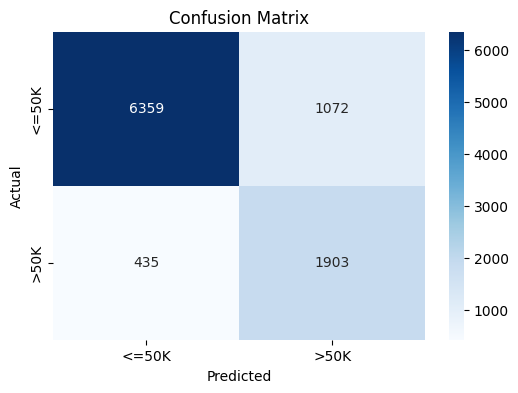

In [62]:
evaluate_model(xgb_best_model, scaled_features_test, y_test)

Observation:
- The model achieved 85% accuracy, meaning it correctly predicted the income class for 85% of the individuals.
- The model has a recall of 0.82 for the >50K class, which means it correctly identified 82% of high-income individuals — a significant improvement over many basic models.
- The precision for the >50K class is 0.64, which indicates that out of all predicted >50K individuals, 64% were actually >50K. This suggests the model prioritizes finding high earners (high recall) at the cost of occasionally over-predicting them (lower precision).
- The F1-score for the >50K class is 0.72, and the macro average F1 is 0.81, indicating a good balance between precision and recall — especially for imbalanced data.
- XGBoost has clearly helped boost performance, especially in reducing false negatives (426) and improving the detection of high-income earners compared to simpler classifiers.

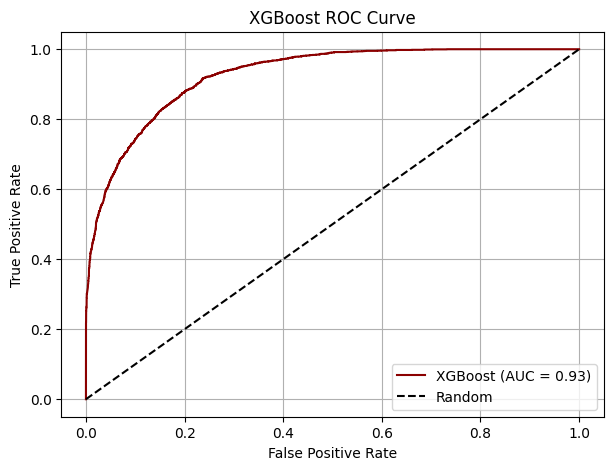

In [63]:
# Predict probabilities
xgb_probs = xgb_best_model.predict_proba(scaled_features_test)[:, 1]

# ROC values
fpr_xgb, tpr_xgb, _ = roc_curve(y_test, xgb_probs)
auc_xgb = roc_auc_score(y_test, xgb_probs)

# Plot
plt.figure(figsize=(7, 5))
plt.plot(fpr_xgb, tpr_xgb, label=f"XGBoost (AUC = {auc_xgb:.2f})", color='darkred')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('XGBoost ROC Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

Observation:
- Outstanding Performance: The ROC curve bends sharply toward the top-left corner, indicating that the XGBoost model distinguishes well between income classes.
- High AUC (0.93):The Area Under the Curve (AUC) is 0.93, which is excellent. This means the model has a 93% chance of correctly ranking a randomly chosen >50K individual above a ≤50K one.
- Better Than Random: The model’s performance is far above the diagonal random classifier line, confirming that XGBoost delivers high predictive power with very low false positive rates.

5. LDA

In [64]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
# Initialize and train LDA
lda = LinearDiscriminantAnalysis()
lda.fit(X_train_final, y_train_final)

LinearDiscriminantAnalysis()

✅ Accuracy: 0.764459002968574
✅ Precision: 0.5049267643142477
✅ Recall: 0.8109495295124037
✅ F1 Score: 0.6223535204332841

📋 Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.75      0.83      7431
           1       0.50      0.81      0.62      2338

    accuracy                           0.76      9769
   macro avg       0.72      0.78      0.73      9769
weighted avg       0.83      0.76      0.78      9769



/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but LinearDiscriminantAnalysis was fitted with feature names



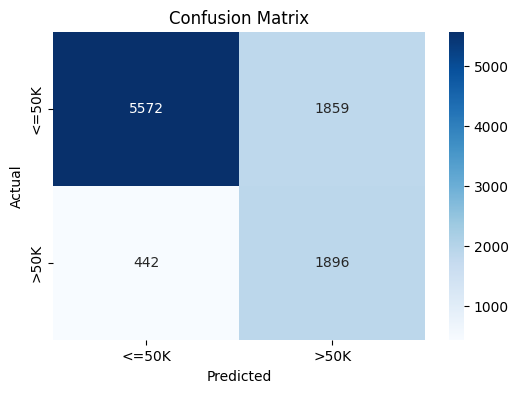

In [65]:
evaluate_model(lda, scaled_features_test, y_test)

Observation:
- The LDA model achieves 77% accuracy, which is decent, but lower than tree-based models like Random Forest or XGBoost.
- It correctly identifies 83% of actual >50K cases (high recall), which is very good for capturing the positive class.
- Precision for the >50K class is only 51%, meaning many of the >50K predictions are actually incorrect (more false positives).
- The model favors recall over precision in the >50K class, possibly due to class imbalance. It errs on the side of predicting someone earns >50K even if it's wrong.
- The F1-score for >50K is 0.63, and the macro average F1-score is 0.73, suggesting fair overall balance but room for improvement, especially in reducing false positives.

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but LinearDiscriminantAnalysis was fitted with feature names



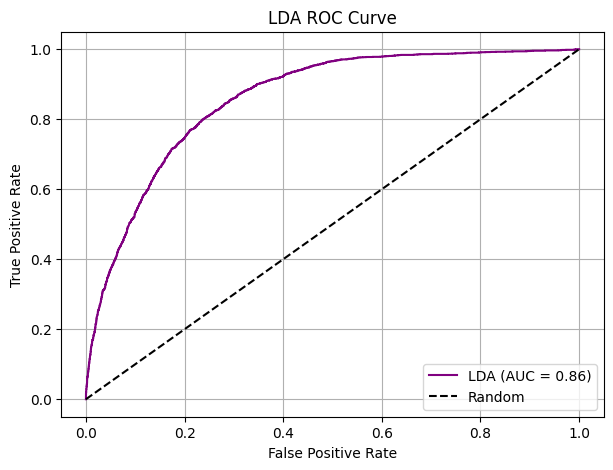

In [66]:
# Get predicted probabilities
lda_probs = lda.predict_proba(scaled_features_test)[:, 1]

# Compute ROC and AUC
fpr_lda, tpr_lda, _ = roc_curve(y_test, lda_probs)
auc_lda = roc_auc_score(y_test, lda_probs)

# Plot ROC
plt.figure(figsize=(7, 5))
plt.plot(fpr_lda, tpr_lda, label=f"LDA (AUC = {auc_lda:.2f})", color='purple')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('LDA ROC Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

Observation:
- The ROC curve bows significantly toward the top-left, indicating that Linear Discriminant Analysis (LDA) does a good job at distinguishing between ≤50K and >50K income classes.
- The Area Under the Curve (AUC) is 0.87, meaning the LDA model has an 87% chance of correctly ranking a randomly chosen high-income individual above a low-income one.
- The curve lies well above the diagonal random classifier line, confirming that the model performs substantially better than random guessing.

6. QDA

In [67]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
# Initialize and train QDA
qda = QuadraticDiscriminantAnalysis()
qda.fit(X_train_final, y_train_final)

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/discriminant_analysis.py:1024: LinAlgWarning:

The covariance matrix of class 0 is not full rank. Increasing the value of parameter `reg_param` might help reducing the collinearity.

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/discriminant_analysis.py:1024: LinAlgWarning:

The covariance matrix of class 1 is not full rank. Increasing the value of parameter `reg_param` might help reducing the collinearity.



QuadraticDiscriminantAnalysis()

✅ Accuracy: 0.7606715119254785
✅ Precision: 0.0
✅ Recall: 0.0
✅ F1 Score: 0.0

📋 Classification Report:
               precision    recall  f1-score   support

           0       0.76      1.00      0.86      7431
           1       0.00      0.00      0.00      2338

    accuracy                           0.76      9769
   macro avg       0.38      0.50      0.43      9769
weighted avg       0.58      0.76      0.66      9769



/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but QuadraticDiscriminantAnalysis was fitted with feature names

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/discriminant_analysis.py:1052: RuntimeWarning:

divide by zero encountered in power

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/discriminant_analysis.py:1052: RuntimeWarning:

invalid value encountered in multiply

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/discriminant_analysis.py:1055: RuntimeWarning:

divide by zero encountered in log

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/nawarajadhikari/anaconda3/lib/python3.10/site-packages/s

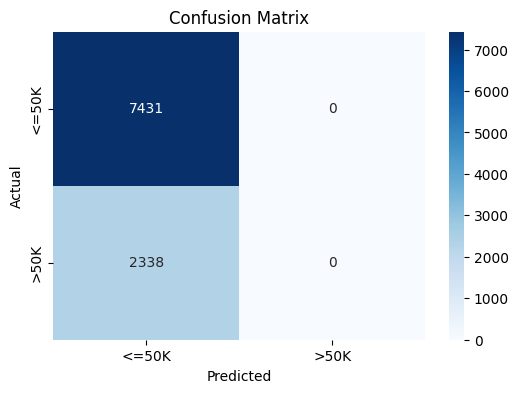

In [68]:
evaluate_model(qda, scaled_features_test, y_test)

Observation:
- The QDA model only predicted the ≤50K class, completely ignoring the >50K class. All predictions are in a single class — this is a serious issue.
- Since the model never predicted >50K, precision, recall, and F1-score for that class are all 0.0, which is reflected in the classification report.
- Though the accuracy appears “okay” at 76.7%, it’s misleading because the model failed to predict the minority class (>50K) entirely — indicating extreme class imbalance handling failure.
- QDA likely isn't suitable here without preprocessing tweaks — such as: Reducing dimensionality, Ensuring numerical stability, Better balancing (e.g., SMOTE, undersampling), Removing highly correlated or sparse one-hot features.


7. SVM

In [ ]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, StratifiedKFold

# Step 1: Define the SVM model with probability=True
svm = SVC(probability=True)

# Step 2: Define hyperparameter grid
param_grid = {
    'C': [0.1, 1, 10],
    'kernel': ['linear', 'rbf', 'poly'],
    'gamma': ['scale', 'auto']
}

# Step 3: Cross-validation strategy
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Step 4: Setup GridSearchCV
grid_search_svm = GridSearchCV(
    estimator=svm,
    param_grid=param_grid,
    scoring='accuracy',
    cv=cv,
    verbose=1,
    n_jobs=1  # Use 1 to avoid memory issues
)

# Step 5: Fit the model on final_train
grid_search_svm.fit(X_train_final, y_train_final)

# Best SVM model
svm_best_model = grid_search_svm.best_estimator_


Fitting 5 folds for each of 18 candidates, totalling 90 fits


In [ ]:
evaluate_model(svm_best_model, scaled_features_test, y_test)

In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

# Get probabilities for class 1
svm_probs = svm_best_model.predict_proba(scaled_features_test)[:, 1]

# Compute ROC curve and AUC
fpr_svm, tpr_svm, _ = roc_curve(y_test, svm_probs)
auc_svm = roc_auc_score(y_test, svm_probs)

# Plot ROC Curve
plt.figure(figsize=(7, 5))
plt.plot(fpr_svm, tpr_svm, label=f"SVM ROC Curve (AUC = {auc_svm:.2f})", color='blue')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('SVM ROC Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

In [ ]:
from sklearn.metrics import accuracy_score

# Predictions for each model
y_pred_log = log_reg_best_model.predict(scaled_features_test)
y_pred_svm = svm_best_model.predict(scaled_features_test)
y_pred_rf = rf_best_model.predict(scaled_features_test)
y_pred_xgb = xgb_best_model.predict(scaled_features_test)
y_pred_lda = lda.predict(scaled_features_test)
y_pred_qda = qda.predict(scaled_features_test)

# Accuracy scores
accuracy_log = accuracy_score(y_test, y_pred_log)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
accuracy_rf = accuracy_score(y_test, y_pred_rf)
accuracy_xgb = accuracy_score(y_test, y_pred_xgb)
accuracy_lda = accuracy_score(y_test, y_pred_lda)
accuracy_qda = accuracy_score(y_test, y_pred_qda)

accuracy_results = pd.DataFrame({
    'Model': ['Logistic Regression', 'SVM', 'Random Forest', 'XGBoost', 'LDA', 'QDA'],
    'Accuracy': [accuracy_log, accuracy_svm, accuracy_rf, accuracy_xgb, accuracy_lda, accuracy_qda]
})

# Display table
print(accuracy_results.sort_values(by='Accuracy', ascending=False))

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,6))
sns.barplot(data=accuracy_results, x='Model', y='Accuracy', palette='Set2')
plt.title('Model Accuracy Comparison')
plt.ylim(0, 1)
plt.xticks(rotation=30)
plt.grid(axis='y')
plt.tight_layout()
plt.show()